In [1]:
import pandas as pd
import natsort as ns
import numpy as np
import nltk
import os
import fakenewsanalyzerptbr as fna
import string
import unidecode
import matplotlib.pyplot as plt
from nltk.util import ngrams
import sklearn
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
import random
from PIL import Image
from wordcloud import WordCloud
import matplotlib.pyplot as plt

In [2]:
path = 'data'
dataset_csv = 'real_and_fake_news_corpus_pt_br.csv'

In [3]:
news = pd.read_csv(os.path.join(path, dataset_csv))

In [4]:
news.name = "ALL NEWS"

In [5]:
news.head(2)

,Id,news_text_full,news_text_normalized,author,link,category,date_of_publication,number_of_tokens,number_of_words_without_punctuation,number_of_types,...,number_of_plural_first_personal_pronouns,number_of_pronouns,pausality,number_of_characters,average_sentence_length,average_word_length,percentage_of_news_with_speeling_errors,emotiveness,diversity,Tag
0,1-FAKE,Kátia Abreu diz que vai colocar sua expulsão e...,Kátia Abreu diz que vai colocar sua expulsão e...,mrk,https://ceticismopolitico.com/2017/11/30/katia...,politica,2017-11-30,211,185,120,...,0,26,2.00000,815,14.2308,4.40541,0.0,0.263158,0.648649,FAKE
1,1-REAL,O Podemos decidiu expulsar o deputado federal...,O Podemos decidiu expulsar o deputado federal...,Naira Trindade,http://politica.estadao.com.br/blogs/coluna-do...,politica,13/12/2017,168,148,107,...,0,7,3.33333,761,24.6667,5.14189,0.0,0.134328,0.722973,REAL


In [104]:
print(np.sum(news['Tag'] == 'REAL'))

3600


In [7]:
classification = news["Tag"].replace(["FAKE", "REAL"], [0, 1])
news["classification"] = classification

/tmp/ipykernel_32948/2526966979.py:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  classification = news["Tag"].replace(["FAKE", "REAL"], [0, 1])


   * Were computed a total of 4629158 words from dataset.



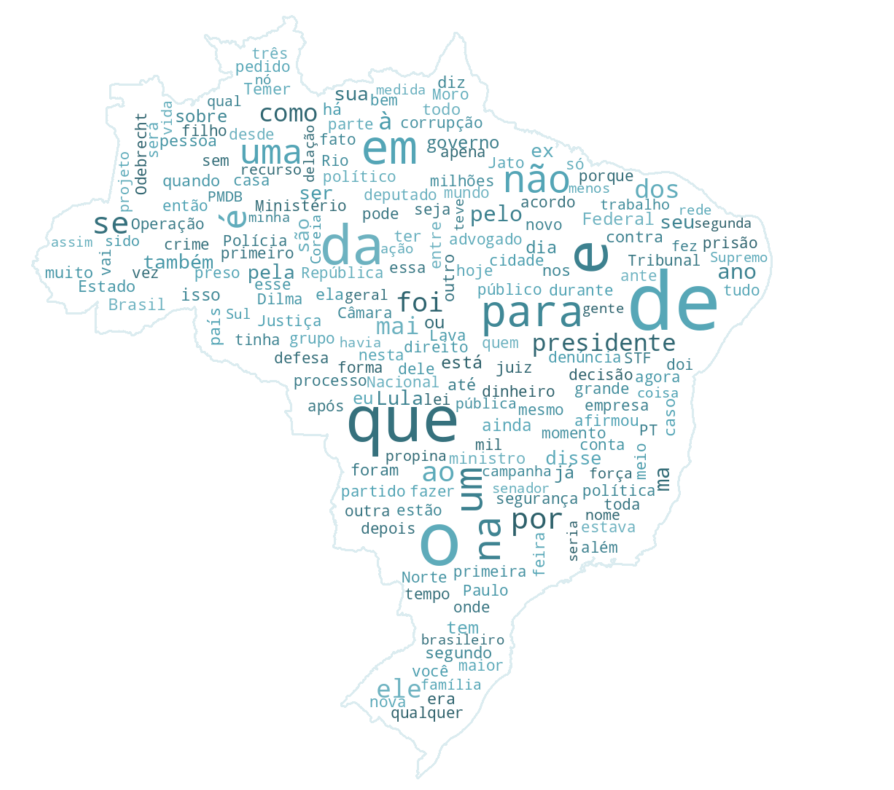

In [8]:
_, all_words, len_all_words = fna.word_cloud_complete(news, "news_text_full", "classification")

In [9]:
len_all_words

4629158

   * Were computed a total of 668106 words from dataset.



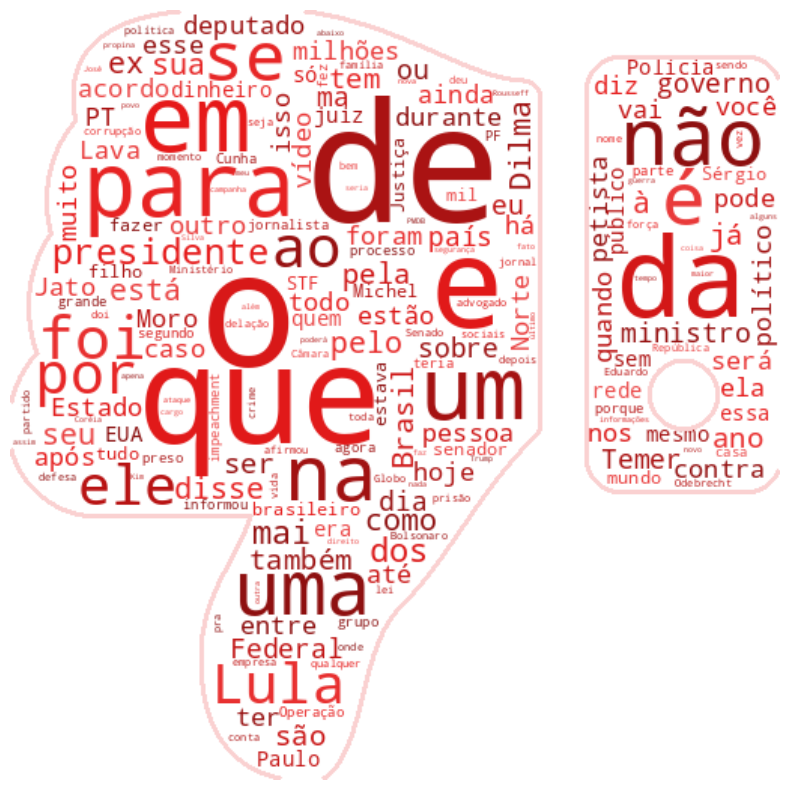

In [10]:
_, fake_words, len_fake_words = fna.word_cloud_fake(news, "news_text_full", "classification")

   * Were computed a total of 3961052 words from dataset.



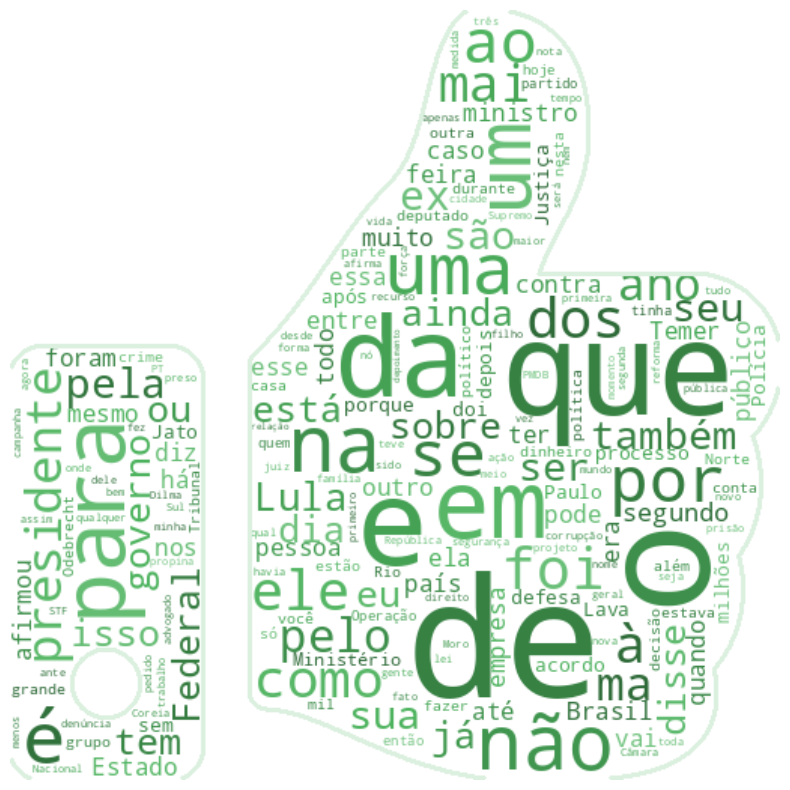

In [11]:
_, real_words, len_real_words = fna.word_cloud_real(news, "news_text_full", "classification")

In [12]:
len(real_words)

24024047

In [13]:
len(news.query('classification == 0'))

3600

In [14]:
news_fake = news.query('classification == 0')
news_real = news.query('classification == 1')
news_fake.head(2)

,Id,news_text_full,news_text_normalized,author,link,category,date_of_publication,number_of_tokens,number_of_words_without_punctuation,number_of_types,...,number_of_pronouns,pausality,number_of_characters,average_sentence_length,average_word_length,percentage_of_news_with_speeling_errors,emotiveness,diversity,Tag,classification
0,1-FAKE,Kátia Abreu diz que vai colocar sua expulsão e...,Kátia Abreu diz que vai colocar sua expulsão e...,mrk,https://ceticismopolitico.com/2017/11/30/katia...,politica,2017-11-30,211,185,120,...,26,2.00000,815,14.2308,4.40541,0.000000,0.263158,0.648649,FAKE,0
2,2-FAKE,Blog esquerdista dá a entender que reclamar de...,Blog esquerdista dá a entender que reclamar de...,NaN,https://ceticismopolitico.com/2017/11/28/blog-...,sociedade_cotidiano,2017-11-28,356,300,187,...,30,3.29412,1321,17.6471,4.40333,0.013333,0.277372,0.623333,FAKE,0


In [15]:
news_real.head(2)

,Id,news_text_full,news_text_normalized,author,link,category,date_of_publication,number_of_tokens,number_of_words_without_punctuation,number_of_types,...,number_of_pronouns,pausality,number_of_characters,average_sentence_length,average_word_length,percentage_of_news_with_speeling_errors,emotiveness,diversity,Tag,classification
1,1-REAL,O Podemos decidiu expulsar o deputado federal...,O Podemos decidiu expulsar o deputado federal...,Naira Trindade,http://politica.estadao.com.br/blogs/coluna-do...,politica,13/12/2017,168,148,107,...,7,3.33333,761,24.6667,5.14189,0.0,0.134328,0.722973,REAL,1
3,2-REAL,Em evento realizado nesta terça-feira para div...,Em evento realizado nesta terça-feira para div...,Estadão Conteúdo,http://esportes.estadao.com.br/noticias/futebo...,sociedade_cotidiano,26/12/2017,349,294,182,...,29,2.75000,1477,14.7000,5.02381,0.0,0.325758,0.619048,REAL,1


In [16]:
list(news_fake['news_text_full'].head(1))

['Kátia Abreu diz que vai colocar sua expulsão em uma moldura, mas não para de reclamar. A senadora Kátia Abreu (sem partido-TO) disse que sua expulsão do PMDB foi resultado de uma ação da cúpula atual da legenda que, segundo ela, é oportunista. “Amanhã eu vou botar numa moldura dourada a minha expulsão, porque das mãos de onde veio, é um atestado de boa conduta para o meu currículo. Essas pessoas que me expulsaram não servem ao país. Eles se servem do país em seus benefícios próprios”, disse Kátia Abreu. Ué, mas se a expulsão é algo tão bom para seu currículo, por que tanta choradeira, Kátia? Sabemos o motivo. Provavelmente Kátia não tem valor para o PT, partido que já deveria tê-la absorvido. Ao que parece o PT gostava de Kátia somente se ela ficasse entrincheirada dentro do PMDB. Ou seja, isso é se rebaixar demais. Resta a Kátia ficar chorando as pitangas por todos os cantos. Em tempo: até o momento o PT não cadastrou Kátia Abreu em suas fileiras. Que situação patética para a ex-min

In [17]:
list(news_fake['author'].unique())

['mrk',
 nan,
 'Josias Oliveira',
 'Josias Oliveirs',
 'Folha do Brasil',
 'Josias Olveira']

In [18]:
news_fake.groupby('author').count()

,Id,news_text_full,news_text_normalized,link,category,date_of_publication,number_of_tokens,number_of_words_without_punctuation,number_of_types,number_of_links_inside_the_news,...,number_of_pronouns,pausality,number_of_characters,average_sentence_length,average_word_length,percentage_of_news_with_speeling_errors,emotiveness,diversity,Tag,classification
author,,,,,,,,,,,,,,,,,,,,,
Folha do Brasil,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
Josias Oliveira,68,68,68,68,68,68,68,68,68,68,...,68,68,68,68,68,68,68,68,68,68
Josias Oliveirs,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
Josias Olveira,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
mrk,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1


In [19]:
news_fake_without_author = news_fake[news_fake['author'].isna()]
print(news_fake_without_author)


             Id                                     news_text_full  \
2        2-FAKE  Blog esquerdista dá a entender que reclamar de...   
4        3-FAKE  Alckmin diz que por ele PSDB desembarca, mas n...   
6        4-FAKE  Cara de pau não tem limites: Zé Celso aciona M...   
8        5-FAKE  Temer resolve o problema de Luislinda: liberda...   
10       6-FAKE  Moro está certo ao não se arrepender de divulg...   
...         ...                                                ...   
7190  3598-FAKE  Deputado do PT não sabia que estava sendo film...   
7192  3599-FAKE  Cunha cancelou a viagem à Itália porque poderi...   
7194  3600-FAKE  Mulher bêbada invade Planalto e diz que é "mar...   
7196  3601-FAKE  Há 400 anos,  Nostradamus previu a vitória de ...   
7198  3602-FAKE  Forças Armadas aparecem em pesquisa como insti...   

                                   news_text_normalized author  \
2     Blog esquerdista dá a entender que reclamar de...    NaN   
4     Alckmin diz que por e

In [20]:
print(news['author'].unique())
print(news['author'].isna().sum())
print(news['author'].isnull().sum())

['mrk' 'Naira Trindade' nan ...
 ' Por Renata Sguissardi Rosa, G1 PR, Curitiba '
 ' Denise Abarca e Niviane Magalhães, O Estado de S.Paulo '
 ' Por Amanda Polato, Adriana Justi, Bibiana Dionísio e Fernando Castro, G1 e G1 PR, São Paulo e Curitiba ']
3575
3575


In [21]:
# news_fake[news_fake.author == 'None'].groupby('author').count()
print(news_fake['author'].isna().sum())

3528


In [22]:
# news_real[news_real.author == 'None'].groupby('author').count()
print(news_real['author'].isna().sum())

47


In [23]:
news["author_score"] = 1

In [24]:
# Criação da coluna "author_score" sendo 1 para autor existente e 0 para notícias sem autor
# Inicializar a coluna 'author_score' com 1 para todas as linhas
news["author_score"] = 1

# Definir 'author_score' como 0 onde 'author' é NaN
news.loc[news['author'].isna(), 'author_score'] = 0

In [25]:
news.head()

,Id,news_text_full,news_text_normalized,author,link,category,date_of_publication,number_of_tokens,number_of_words_without_punctuation,number_of_types,...,pausality,number_of_characters,average_sentence_length,average_word_length,percentage_of_news_with_speeling_errors,emotiveness,diversity,Tag,classification,author_score
0,1-FAKE,Kátia Abreu diz que vai colocar sua expulsão e...,Kátia Abreu diz que vai colocar sua expulsão e...,mrk,https://ceticismopolitico.com/2017/11/30/katia...,politica,2017-11-30,211,185,120,...,2.00000,815,14.2308,4.40541,0.000000,0.263158,0.648649,FAKE,0,1
1,1-REAL,O Podemos decidiu expulsar o deputado federal...,O Podemos decidiu expulsar o deputado federal...,Naira Trindade,http://politica.estadao.com.br/blogs/coluna-do...,politica,13/12/2017,168,148,107,...,3.33333,761,24.6667,5.14189,0.000000,0.134328,0.722973,REAL,1,1
2,2-FAKE,Blog esquerdista dá a entender que reclamar de...,Blog esquerdista dá a entender que reclamar de...,NaN,https://ceticismopolitico.com/2017/11/28/blog-...,sociedade_cotidiano,2017-11-28,356,300,187,...,3.29412,1321,17.6471,4.40333,0.013333,0.277372,0.623333,FAKE,0,0
3,2-REAL,Em evento realizado nesta terça-feira para div...,Em evento realizado nesta terça-feira para div...,Estadão Conteúdo,http://esportes.estadao.com.br/noticias/futebo...,sociedade_cotidiano,26/12/2017,349,294,182,...,2.75000,1477,14.7000,5.02381,0.000000,0.325758,0.619048,REAL,1,1
4,3-FAKE,"Alckmin diz que por ele PSDB desembarca, mas n...","Alckmin diz que por ele PSDB “desembarca”, mas...",NaN,https://ceticismopolitico.com/2017/11/28/alckm...,politica,2017-11-28,274,224,150,...,3.57143,1075,16.0000,4.79911,0.000000,0.262136,0.669643,FAKE,0,0


In [26]:
# Contagem de notícias sem autor
news[news.author_score == 0].groupby('classification').count()

,Id,news_text_full,news_text_normalized,author,link,category,date_of_publication,number_of_tokens,number_of_words_without_punctuation,number_of_types,...,number_of_pronouns,pausality,number_of_characters,average_sentence_length,average_word_length,percentage_of_news_with_speeling_errors,emotiveness,diversity,Tag,author_score
classification,,,,,,,,,,,,,,,,,,,,,
0,3528,3528,3528,0,3528,3528,3528,3528,3528,3528,...,3528,3528,3528,3528,3528,3528,3528,3528,3528,3528
1,47,47,47,0,47,47,47,47,47,47,...,47,47,47,47,47,47,47,47,47,47


# Preprocessamento do dataset:

In [27]:
unicodes_to_strip = {
            "\n\n": " ",
            "\n": " ",
            "\ufeff": "",
            "\x85": "",
            "\x91": "",
            "\x92": "",
            "\x93": "",
            "\x94": "",
            "\x96": "",
            "\x97": ""
        }
personalized_simbols = ["“",
                        "”",
                        ",",
                        "”,",
                        '""."',
                        '"),"',
                        '–',
                        'R',
                        '..',
                        '""","',
                        '[...]',
                        ').',
                        '...',
                        '"."""',
                        '),',
                        '".',
                        'aa']
string.punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [28]:
# Conversão da string de pontuações em lista
punctuation_list = list()
for punct in string.punctuation:
    punctuation_list.append(punct)
# Adicionando strings de pontuação que não estão presentes em string.punctuation (“ e ”)
punctuation_simbols_list = punctuation_list + personalized_simbols
punctuation_simbols_list[:10]

['!', '"', '#', '$', '%', '&', "'", '(', ')', '*']

In [29]:
# TESTE - Decodificar texto já sem acentos nem unicode
with open('data/full_texts/fake/2.txt', 'r', encoding='utf8') as text:
    teste1 = unidecode.unidecode(text.read())
    for key in unicodes_to_strip:
        teste1 = teste1.replace(key, unicodes_to_strip[key])
teste1[:150]

'Blog esquerdista da a entender que reclamar de dedada no futebol e sinal de homofobia. Um texto de Jorge Gauthier, para o blog Me Salte, do jornal Cor'

In [30]:
with open(os.path.join('data','stopwords_nltk_ordered.txt'), 'r', encoding='utf8') as text:
    stop_words_extended = text.read().splitlines()
stop_words_extended = set(nltk.tokenize.wordpunct_tokenize(unidecode.unidecode(' '.join(stop_words_extended))))

In [31]:
clean_phrases = list()
tokens_traitement_1 = list()
stop_words_nltk = stop_words_extended
for text in news.news_text_full:
    # Decodificar texto sem acentos nem unicode
    news_text = unidecode.unidecode(text)
    for key in unicodes_to_strip:
        # Retira \n e \n\n, principalmente, além dos demais unicodes que possam ter sobrado.
        news_text = news_text.replace(key, unicodes_to_strip[key])
    # Retira stopwords:
    filtered_news = [w for w in nltk.tokenize.wordpunct_tokenize(news_text) if not w in stop_words_nltk]
    # Retira pontuação e deixa todas as palavras em minúsculo:
    filtered_news = [word.lower() for word in filtered_news if not word in (punct for punct in punctuation_simbols_list)]
    filtered_news = [w for w in filtered_news if w.isalpha()]
    filtered_news = [w for w in filtered_news if not w in stop_words_nltk]
    tokens_traitement_1.append(len(filtered_news))
    clean_phrases.append(filtered_news)
# Criar lista com frases tokenizadas e tratadas:
news['traitement_1'] = clean_phrases
# Criar coluna number_of_tokens_traitement_1
news['number_of_tokens_traitement_1'] = tokens_traitement_1

In [32]:
nltk.tokenize.wordpunct_tokenize("Olá! Eu chamo-me Guilherme.")

['Olá', '!', 'Eu', 'chamo', '-', 'me', 'Guilherme', '.']

In [33]:
news.traitement_1.head()

0    [katia, abreu, diz, vai, colocar, expulsao, mo...
1    [podemos, decidiu, expulsar, deputado, federal...
2    [blog, esquerdista, entender, reclamar, dedada...
3    [evento, realizado, nesta, terca, feira, divul...
4    [alckmin, diz, psdb, desembarca, explica, util...
Name: traitement_1, dtype: object

In [34]:
nltk.download('rslp')
st = nltk.stem.RSLPStemmer()
stem_traitement_1 = list()
for instance in news.traitement_1:
    stem_phrase = list()
    for word in instance:
        stem_phrase.append(st.stem(word))
    stem_traitement_1.append(stem_phrase)
news['traitement_2'] = stem_traitement_1

[nltk_data] Downloading package rslp to /home/vscode/nltk_data...
[nltk_data]   Package rslp is already up-to-date!


In [35]:
news.traitement_2[:2]

0    [kat, abr, diz, vai, coloc, expulsa, mold, rec...
1    [pod, decid, expuls, deput, feder, carl, gagui...
Name: traitement_2, dtype: object

In [36]:
# Calculando as médias
media_palavras_total = news['number_of_tokens'].mean()
media_palavras_falsas = news[news['classification'] == 0]['number_of_tokens'].mean()
media_palavras_verdadeiras = news[news['classification'] == 1]['number_of_tokens'].mean()

media_palavras_tratamento_total = news['number_of_tokens_traitement_1'].mean()
media_palavras_tratamento_falsas = news[news['classification'] == 0]['number_of_tokens_traitement_1'].mean()
media_palavras_tratamento_verdadeiras = news[news['classification'] == 1]['number_of_tokens_traitement_1'].mean()

# Exibindo as médias
print(f"Número médio de palavras antes da retirada das stopwords, pontuações e símbolos:\n\t\t\t\t\t\t{media_palavras_total:.2f} palavras/tokens por notícia\nsendo:\n")
print(f"Média de palavras das notícias FALSAS:\t\t{media_palavras_falsas:.2f}\n")
print(f"Média de palavras das notícias VERDADEIRAS:\t{media_palavras_verdadeiras:.2f}\n")

print(f"Já para o primeiro tratamento, restaram:\n\t\t\t\t\t\t{media_palavras_tratamento_total:.2f} palavras em média por notícia\nsendo:\n")
print(f"Média de palavras das notícias FALSAS:\t\t{media_palavras_tratamento_falsas:.2f}\n")
print(f"Média de palavras das notícias VERDADEIRAS:\t{media_palavras_tratamento_verdadeiras:.2f}\n")


Número médio de palavras antes da retirada das stopwords, pontuações e símbolos:
						742.76 palavras/tokens por notícia
sendo:

Média de palavras das notícias FALSAS:		216.24

Média de palavras das notícias VERDADEIRAS:	1269.29

Já para o primeiro tratamento, restaram:
						359.78 palavras em média por notícia
sendo:

Média de palavras das notícias FALSAS:		105.92

Média de palavras das notícias VERDADEIRAS:	613.65



In [37]:
news[news.author_score == 0].groupby('classification').count()

,Id,news_text_full,news_text_normalized,author,link,category,date_of_publication,number_of_tokens,number_of_words_without_punctuation,number_of_types,...,average_sentence_length,average_word_length,percentage_of_news_with_speeling_errors,emotiveness,diversity,Tag,author_score,traitement_1,number_of_tokens_traitement_1,traitement_2
classification,,,,,,,,,,,,,,,,,,,,,
0,3528,3528,3528,0,3528,3528,3528,3528,3528,3528,...,3528,3528,3528,3528,3528,3528,3528,3528,3528,3528
1,47,47,47,0,47,47,47,47,47,47,...,47,47,47,47,47,47,47,47,47,47


In [38]:
print("NÚMERO DE NOTÍCIAS SEM AUTORIA ASSINADA:\n\n")
print("Falsas:          {}".format(news[news.author_score == 0].groupby('classification').count()['Id'][0]))
print("Verdadeiras:     {}".format(news[news.author_score == 0].groupby('classification').count()['Id'][1]))

NÚMERO DE NOTÍCIAS SEM AUTORIA ASSINADA:


Falsas:          3528
Verdadeiras:     47


In [39]:
# Retirando pontuação e números. Deixando todas as palavras em minúsculo
# isalpha() retirou palavras com hífem, números e simbolos úteis. Não usar!
# teste2 = [w.lower() for w in filtered_news if w.isalpha()]

In [40]:
# Criar dataframes FAKE e REAL:
all_news_words = list()
all_real_news_words = list()
all_fake_news_words = list()
news_fake = news.query('classification == 0')
news_fake.name = 'FAKE NEWS'
news_real = news.query('classification == 1')
news_real.name = 'REAL NEWS'


In [41]:
news_fake['traitement_2'].tail()

7190    [deput, pt, sab, send, film, confess, dilm, us...
7192    [cunh, cancel, viag, ital, porqu, pod, pres, e...
7194    [mulh, beb, invad, planalt, diz, marid, presid...
7196    [ano, nostradamu, prev, vitor, donald, trump, ...
7198    [forc, arm, aparec, pesquis, instituica, confi...
Name: traitement_2, dtype: object

In [42]:
news_fake = news_fake.reset_index()
news_real = news_real.reset_index()

In [43]:
# TRUNCAR NOTÍCIAS
# Medir tamanhos e podar o maior pelo menor
news_fake['traitement_3'] = ''
news_real['traitement_3'] = ''

for row in range(len(news_fake)):
    if len(news_fake.traitement_2[row]) > len(news_real.traitement_2[row]):
        news_fake.traitement_3[row] = news_fake.traitement_2[row][:len(news_real.traitement_2[row])]
        news_real.traitement_3[row] = news_real.traitement_2[row]
    else:
        news_real.traitement_3[row] = news_real.traitement_2[row][:len(news_fake.traitement_2[row])]
        news_fake.traitement_3[row] = news_fake.traitement_2[row]

/tmp/ipykernel_32948/1177384583.py:8: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  news_fake.traitement_3[row] = news_fake.traitement_2[row][:len(news_real.traitement_2[row])]
/tmp/ipykernel_32948/1177384583.py:8: SettingWithCopyWarning: 
A

In [44]:
token_count = []
for news_text in news_fake['traitement_3']:
    token_count.append(len(news_text))

In [45]:
# Unificar dataset:
# token_count
count_fake_real_news = -1
news['traitement_3'] = ''
for row in range(len(news)):
    if row % 2 == 0:
        count_fake_real_news += 1
        news['traitement_3'][row] = news_fake['traitement_3'][count_fake_real_news]
    else:
        news['traitement_3'][row] = news_real['traitement_3'][count_fake_real_news]
    


/tmp/ipykernel_32948/3788455239.py:8: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  news['traitement_3'][row] = news_fake['traitement_3'][count_fake_real_news]
/tmp/ipykernel_32948/3788455239.py:8: SettingWithCopyWarning: 
A value is trying 

In [46]:
news_fake.name = 'FAKE NEWS'
news_real.name = 'REAL NEWS'

        Word  Frequency Classification
194   presid       3177      FAKE NEWS
381      lul       3088      FAKE NEWS
461   brasil       2591      FAKE NEWS
11      diss       2406      FAKE NEWS
136      pod       2229      FAKE NEWS
...      ...        ...            ...
90     ocorr        337      FAKE NEWS
182    assim        333      FAKE NEWS
256     sant        333      FAKE NEWS
74       hor        332      FAKE NEWS
1559  defend        332      FAKE NEWS

[200 rows x 3 columns]


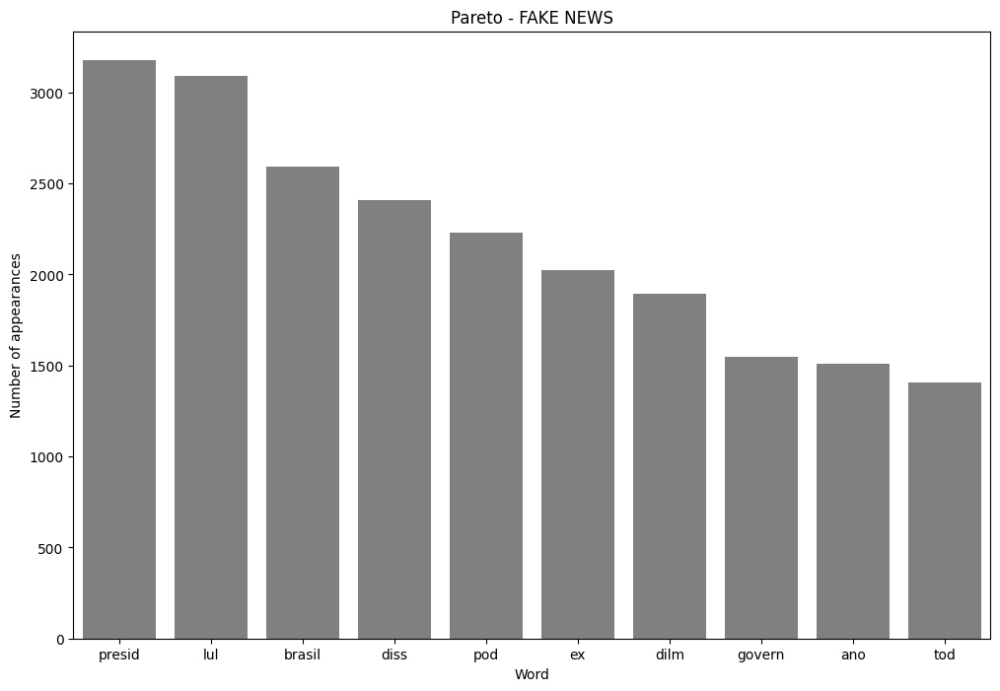

375303

In [47]:
# PARETO
# coluna a ser analisada:
df = news_fake
df_col = 'traitement_3'

fna.pareto_df_tokenized(df, df_col, 10)

        Word  Frequency Classification
199   presid       3660      REAL NEWS
88       ano       2692      REAL NEWS
315       ex       2600      REAL NEWS
74      feir       2300      REAL NEWS
4      feder       2168      REAL NEWS
...      ...        ...            ...
71    realiz        340      REAL NEWS
1377   centr        339      REAL NEWS
256      jos        338      REAL NEWS
311       pf        338      REAL NEWS
130   precis        336      REAL NEWS

[200 rows x 3 columns]


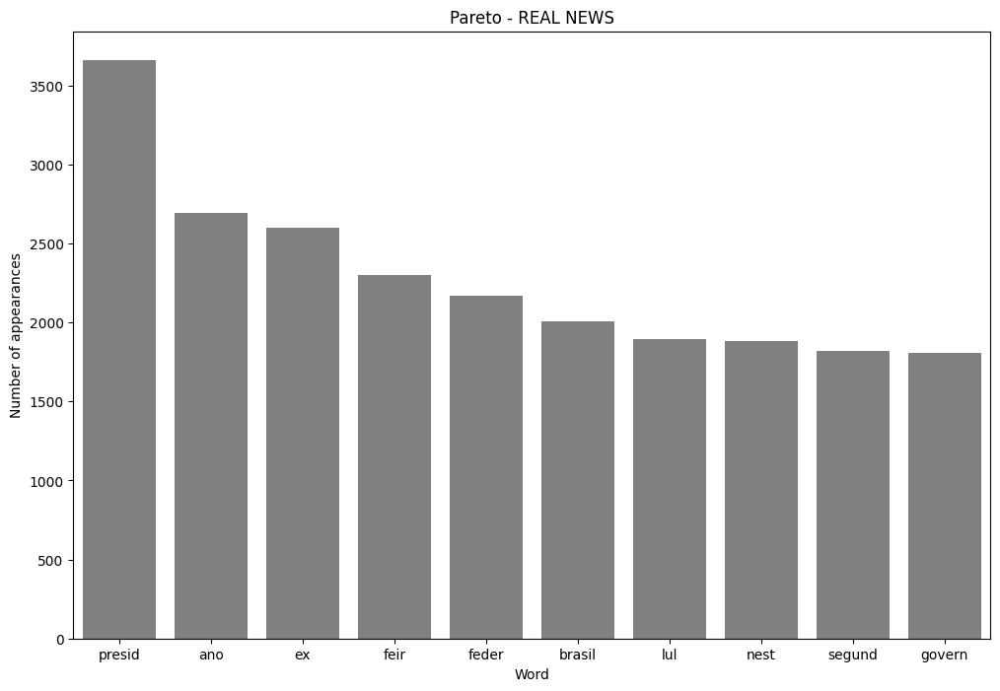

375303

In [48]:

# PARETO
# coluna a ser analisada:
df = news_real
df_col = 'traitement_3'

fna.pareto_df_tokenized(df, df_col, 10)

In [49]:
# Todas as palavras unificadas
col = 'traitement_3'
# for news_text in news[col]:
#     for word in news_text:
#        all_news_words.append(word)
all_fake_news_words = []
all_real_news_words = []
for news_text in news_fake[col]:
    for word in news_text:
       all_fake_news_words.append(word)

for news_text in news_real[col]:
    for word in news_text:       
       all_real_news_words.append(word)

In [50]:
len(all_fake_news_words)

375303

In [51]:
len(all_real_news_words)

375303

In [52]:
bigrams_to_suppress = [
    ('ex', 'presid'),
    ('lav','jat'),
    ('segund','feir'),
    ('terc','feir'),
    ('quart','feir'),
    ('quint','feir'),
    ('sext','feir'),
    ('michel','tem'),
    ('sergi', 'mor'),
    ('dilm', 'rousseff'),
    ('eduard', 'cunh')]

In [53]:
bigrams_fake = list(ngrams(all_fake_news_words, 2))
bigrams2 = []

for bigram in bigrams_fake:
    bigram2 = []
    if not bigram in (bigram for bigram in bigrams_to_suppress):
        for word in bigram:
            bigram2.append(word)
        bigrams2.append(' '.join(bigram2))

bigrams_fake = bigrams2
bigrams_fake[:3]

['kat abr', 'abr diz', 'diz vai']

In [54]:
len(bigrams_fake)

371353

In [55]:
def word_cloud_bigram(bigrams, mask):
    len_bigrams = len(bigrams)
    print("   * Were computed a total of {} bigrams from dataset.\n".format(len_bigrams))
    
    mask_default = "cloud_mask.png"
    #if os.path.join("data", "img", mask)
        
    def color_function(mask):
        if mask == "mapa_brasil_mask.png":
            def color_func(word, font_size, position, orientation, random_state=None,**kwargs):
                return "hsl(190, 40%%, %d%%)" % random.randint(30, 60) #sky
            color_cont = (219, 236, 240)
        elif mask == "thumbs_down_mask_3.png":
            def color_func(word, font_size, position, orientation, random_state=None,**kwargs):
                return "hsl(0, 80%%, %d%%)" % random.randint(30, 60) #fake
            color_cont = (250, 209, 209)
        elif mask == "thumbs_up_mask.png":
            def color_func(word, font_size, position, orientation, random_state=None,**kwargs):
                return "hsl(130, 40%%, %d%%)" % random.randint(30, 60) #real
            color_cont = (219, 240, 223)
        else:
            def color_func(word, font_size, position, orientation, random_state=None,**kwargs):
                return "hsl(0, 0%%, %d%%)" % random.randint(60, 100) #grey
            color_cont = (219, 236, 240)
        return color_func, color_cont

    color_function, color_cont = color_function(mask)

    vectorizer = CountVectorizer(ngram_range=(2, 2))
    bag_of_words = vectorizer.fit_transform(bigrams)
    vectorizer.vocabulary_
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vectorizer.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    words_dict = dict(words_freq)

    mask = np.array(Image.open(os.path.join("data", "img", mask)))

    # cloud_of_words = WordCloud(width = 1080,
    #                            height = 1080,
    #                            max_font_size = 110,
    #                            collocations = False,
    #                            mask = mask,
    #                            background_color = "white",
    #                            contour_width = 3,
    #                            contour_color = (219, 236, 240)).generate_from_frequencies(words_dict)
    # cloud_of_words.recolor(color_func=color_func, random_state=3)

    WC_height = 1000
    WC_width = 1500
    WC_max_words = 200
    cloud_of_words = WordCloud(height=1080,
                               width=1080,
                               max_font_size = 110,
                               collocations = False,
                               background_color = "white",
                               mask = mask,
                               contour_width = 3,
                               contour_color = color_cont)
    cloud_of_words.generate_from_frequencies(words_dict)
    cloud_of_words.recolor(color_func=color_function, random_state=3)
    #plt.title('Most frequently occurring bigrams connected by same colour and font size')
    plt.figure(figsize = (12, 10))
    plt.imshow(cloud_of_words, interpolation = 'bilinear')
    plt.axis('off')
    plt.show()
    return cloud_of_words, len_bigrams

In [56]:
bigrams_real = list(ngrams(all_real_news_words, 2))
bigrams2 = []

for bigram in bigrams_real:
    bigram2 = []
    if not bigram in (bigram for bigram in bigrams_to_suppress):
        for word in bigram:
            bigram2.append(word)
        bigrams2.append(' '.join(bigram2))

bigrams_real = bigrams2
bigrams_real[:3]

['pod decid', 'decid expuls', 'expuls deput']

   * Were computed a total of 371353 bigrams from dataset.



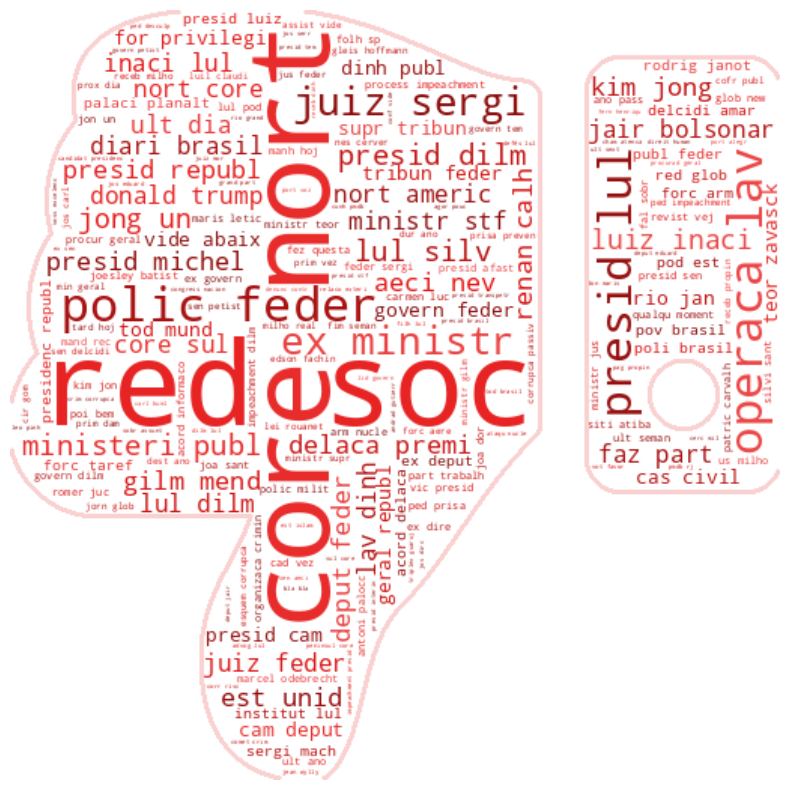

(<wordcloud.wordcloud.WordCloud at 0x7f4b7db40b90>, 371353)

In [57]:
word_cloud_bigram(bigrams_fake, "thumbs_down_mask_3.png")

   * Were computed a total of 369298 bigrams from dataset.



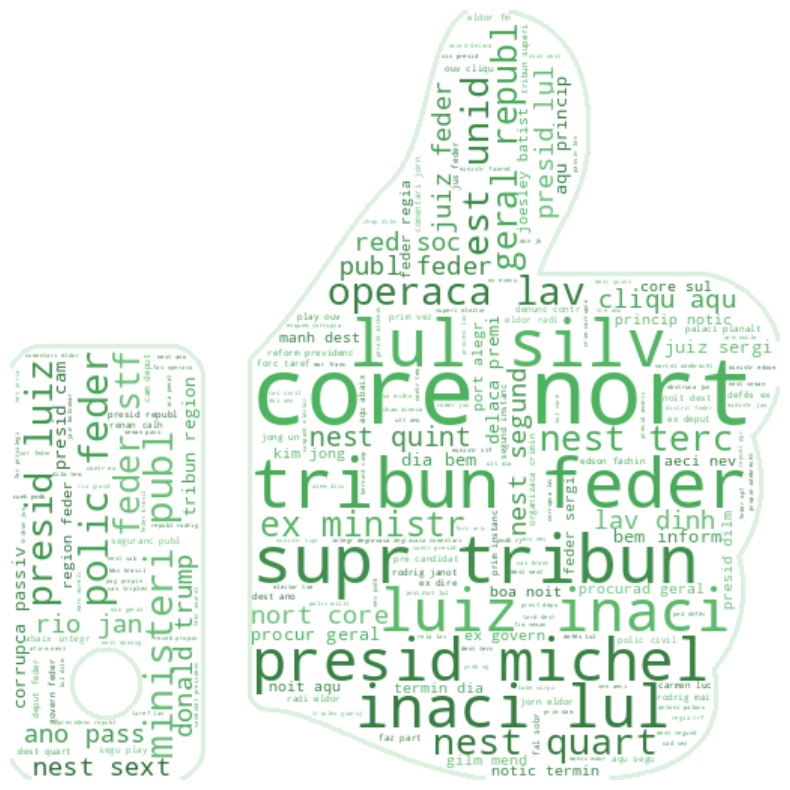

(<wordcloud.wordcloud.WordCloud at 0x7f4b7db7d460>, 369298)

In [58]:
word_cloud_bigram(bigrams_real, "thumbs_up_mask.png")

                 Word  Frequency Classification
1829          red soc        468           FAKE
38829       core nort        435           FAKE
2000      polic feder        321           FAKE
2325      operaca lav        299           FAKE
2789       presid lul        282           FAKE
...               ...        ...            ...
82348      jos eduard         41           FAKE
2317     denunc contr         40           FAKE
4170       tod brasil         40           FAKE
5841   triplex guaruj         40           FAKE
12223      presid tem         40           FAKE

[200 rows x 3 columns]


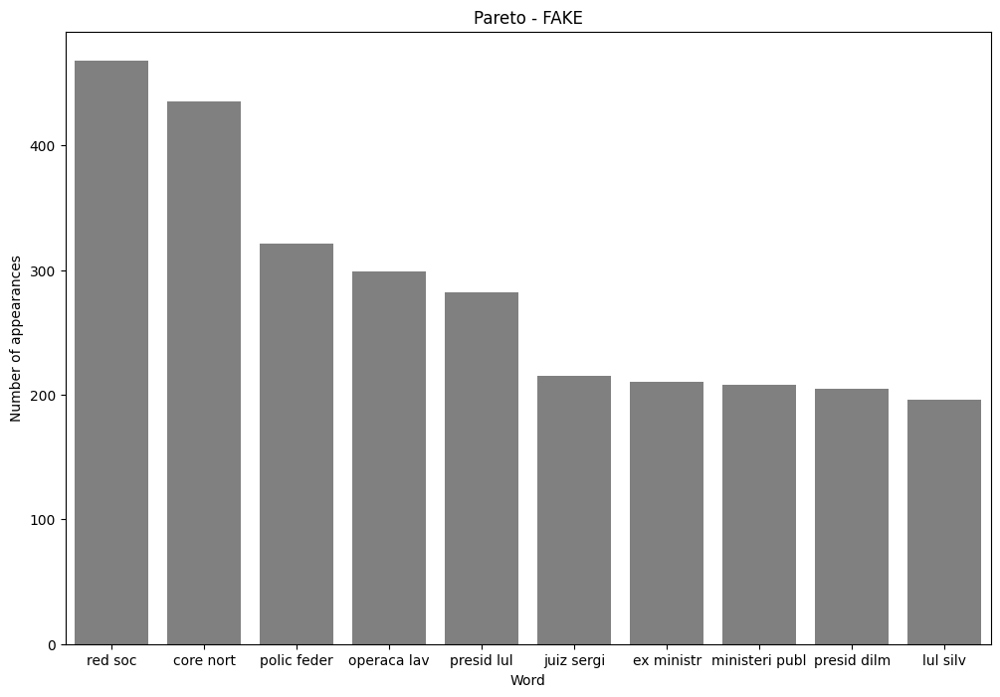

371353

In [59]:
fna.pareto_all_tokenized(bigrams_fake, 'FAKE', 10)

                Word  Frequency Classification
37494      core nort        512           REAL
1209    tribun feder        460           REAL
1208     supr tribun        458           REAL
3458        lul silv        438           REAL
1098   presid michel        418           REAL
...              ...        ...            ...
21008    ministr jus         54           REAL
1134       romer juc         53           REAL
7973    feder brasil         53           REAL
11577    cham atenca         53           REAL
13317      taref lav         53           REAL

[200 rows x 3 columns]


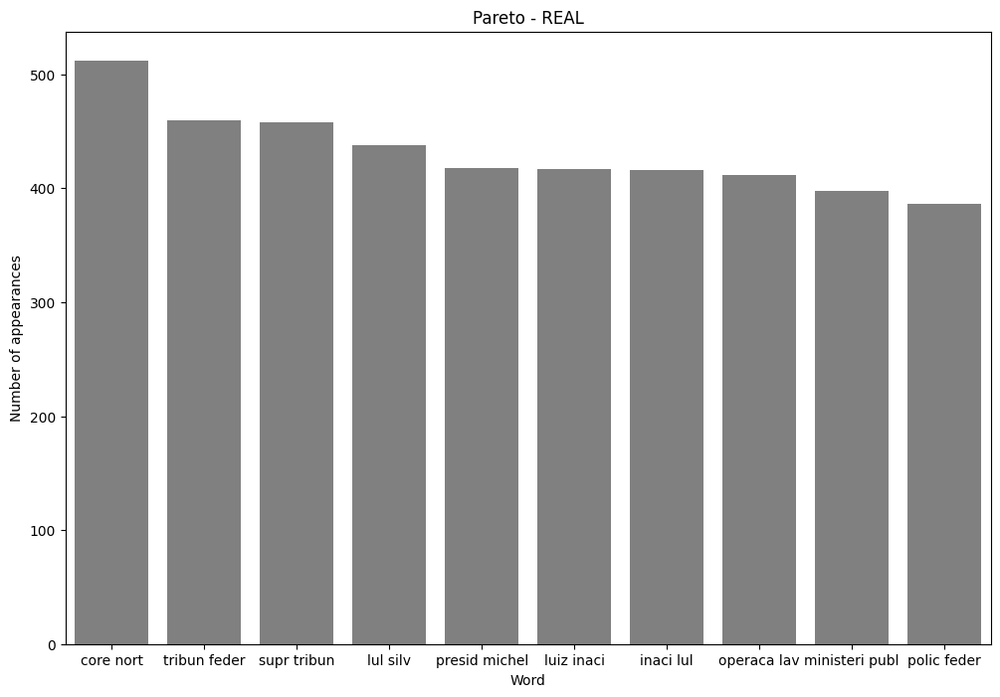

369298

In [60]:
fna.pareto_all_tokenized(bigrams_real, 'REAL', 10)

In [61]:
news.head()

,Id,news_text_full,news_text_normalized,author,link,category,date_of_publication,number_of_tokens,number_of_words_without_punctuation,number_of_types,...,percentage_of_news_with_speeling_errors,emotiveness,diversity,Tag,classification,author_score,traitement_1,number_of_tokens_traitement_1,traitement_2,traitement_3
0,1-FAKE,Kátia Abreu diz que vai colocar sua expulsão e...,Kátia Abreu diz que vai colocar sua expulsão e...,mrk,https://ceticismopolitico.com/2017/11/30/katia...,politica,2017-11-30,211,185,120,...,0.000000,0.263158,0.648649,FAKE,0,1,"[katia, abreu, diz, vai, colocar, expulsao, mo...",98,"[kat, abr, diz, vai, coloc, expulsa, mold, rec...","[kat, abr, diz, vai, coloc, expulsa, mold, rec..."
1,1-REAL,O Podemos decidiu expulsar o deputado federal...,O Podemos decidiu expulsar o deputado federal...,Naira Trindade,http://politica.estadao.com.br/blogs/coluna-do...,politica,13/12/2017,168,148,107,...,0.000000,0.134328,0.722973,REAL,1,1,"[podemos, decidiu, expulsar, deputado, federal...",82,"[pod, decid, expuls, deput, feder, carl, gagui...","[pod, decid, expuls, deput, feder, carl, gagui..."
2,2-FAKE,Blog esquerdista dá a entender que reclamar de...,Blog esquerdista dá a entender que reclamar de...,NaN,https://ceticismopolitico.com/2017/11/28/blog-...,sociedade_cotidiano,2017-11-28,356,300,187,...,0.013333,0.277372,0.623333,FAKE,0,0,"[blog, esquerdista, entender, reclamar, dedada...",162,"[blog, esquerd, entend, reclam, ded, futebol, ...","[blog, esquerd, entend, reclam, ded, futebol, ..."
3,2-REAL,Em evento realizado nesta terça-feira para div...,Em evento realizado nesta terça-feira para div...,Estadão Conteúdo,http://esportes.estadao.com.br/noticias/futebo...,sociedade_cotidiano,26/12/2017,349,294,182,...,0.000000,0.325758,0.619048,REAL,1,1,"[evento, realizado, nesta, terca, feira, divul...",157,"[event, realiz, nest, terc, feir, divulg, jog,...","[event, realiz, nest, terc, feir, divulg, jog,..."
4,3-FAKE,"Alckmin diz que por ele PSDB desembarca, mas n...","Alckmin diz que por ele PSDB “desembarca”, mas...",NaN,https://ceticismopolitico.com/2017/11/28/alckm...,politica,2017-11-28,274,224,150,...,0.000000,0.262136,0.669643,FAKE,0,0,"[alckmin, diz, psdb, desembarca, explica, util...",125,"[alckmin, diz, psdb, desembarc, explic, utiliz...","[alckmin, diz, psdb, desembarc, explic, utiliz..."


In [62]:
processed_phrase = list()
for phrase in news['traitement_3']:
    processed_phrase.append(' '.join(phrase))

news['traitement_4'] = processed_phrase

In [63]:
accuracy_bag_traitement_4 = fna.text_classifier(news, 'traitement_4', 'classification')

=============================== START =============================== 

LOGISTIC REGRESSION WITH BAG OF WORDS FOR THE 123 MOST FREQUENT WORDS

The bag of words created has 7200 instances with 123 words.

Will be used 5400 instances for training.

Will be used 1800 instances for testing the trained model.

      acord  advog  afirm  aind  algum  ano  apo  apresent  bem  brasil  ...  \
0         0      0      0     0      0    0    0         0    0       0  ...   
1         1      0      0     1      0    0    2         0    0       0  ...   
2         0      0      2     0      1    0    1         0    0       0  ...   
3         0      0      0     1      3    2    0         0    1       0  ...   
4         1      0      0     0      0    0    1         0    0       0  ...   
...     ...    ...    ...   ...    ...  ...  ...       ...  ...     ...  ...   
7195      0      0      0     0      0    0    0         0    0       0  ...   
7196      1      0      0     0      1    1    0     

In [64]:
accuracy_bag_news_text_full = fna.text_classifier(news, 'news_text_full', 'classification')

=============================== START =============================== 

LOGISTIC REGRESSION WITH BAG OF WORDS FOR THE 123 MOST FREQUENT WORDS

The bag of words created has 7200 instances with 123 words.

Will be used 5400 instances for training.

Will be used 1800 instances for testing the trained model.

      Brasil  Câmara  Dilma  Ele  Em  Eu  Federal  Jato  Justiça  Lava  ...  \
0          0       0      1    0   1   0        0     0        0     0  ...   
1          0       1      0    0   0   0        1     0        0     0  ...   
2          0       0      0    1   0   0        0     0        0     0  ...   
3          0       0      0    0   1   0        0     0        0     0  ...   
4          0       0      1    1   0   1        0     0        0     0  ...   
...      ...     ...    ...  ...  ..  ..      ...   ...      ...   ...  ...   
7195       1       0      0    1   0   0        0     0        0     0  ...   
7196       0       0      0    0   0   0        0     0      

/home/vscode/.local/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [65]:
accuracy_bag_news_text_normalized = fna.text_classifier(news, 'news_text_normalized', 'classification')

=============================== START =============================== 

LOGISTIC REGRESSION WITH BAG OF WORDS FOR THE 123 MOST FREQUENT WORDS

The bag of words created has 7200 instances with 123 words.

Will be used 5400 instances for training.

Will be used 1800 instances for testing the trained model.

      Brasil  Coreia  Câmara  Dilma  EUA  Ele  Em  Federal  Jato  Justiça  \
0          0       0       0      0    0    0   0        0     0        0   
1          0       0       1      0    0    0   0        1     0        0   
2          0       0       0      0    0    1   0        0     0        0   
3          0       0       0      0    0    0   1        0     0        0   
4          0       0       0      1    0    1   0        0     0        0   
...      ...     ...     ...    ...  ...  ...  ..      ...   ...      ...   
7195       0       0       0      0    0    0   0        0     0        0   
7196       0       0       0      0    0    0   0        0     0        0   


In [66]:
# Criação do modelo de regressão logística e de TF-IDF:
from sklearn.feature_extraction.text import TfidfVectorizer
regressao_logistica = LogisticRegression(solver = 'lbfgs')
tfidf = TfidfVectorizer(lowercase = False, max_features = 500)

In [67]:
(x_treino, 
 x_teste, 
 classe_treino, 
 classe_teste) = train_test_split(news["news_text_full"],
                                  news["classification"],
                                  random_state = 42)
 
 # Acurácia do TF-IDF para os textos completos sem tratamento:
## Mudar a ordem para vetorizar textos em TFIDF somente após separação em teste e treini. Usar tfidf.transform() nos textos de teste após fit nos treinamentos
treino = tfidf_text_full = tfidf.fit_transform(x_treino)
teste = tfidf.transform(x_teste)

regressao_logistica.fit(treino, classe_treino)
acuracia__tfidf_text_full = regressao_logistica.score(teste, classe_teste)
print(acuracia__tfidf_text_full)

#Para visualizar a matriz de frequências:
caracteristicas = tfidf.fit_transform(news["news_text_full"])
pd.DataFrame(
     caracteristicas.todense(),
     columns = tfidf.get_feature_names_out())

0.9405555555555556


,10,11,12,15,20,2014,2015,2016,2017,2018,...,vida,violência,você,volta,vão,vídeo,às,área,época,última
0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,...,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,...,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,...,0.080155,0.000000,0.081498,0.0,0.000000,0.086759,0.000000,0.000000,0.000000,0.000000
3,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,...,0.000000,0.000000,0.157545,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,...,0.000000,0.000000,0.000000,0.0,0.100685,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7195,0.065300,0.037605,0.000000,0.0,0.000000,0.035668,0.000000,0.000000,0.000000,0.0,...,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.027345,0.037665,0.000000,0.035592
7196,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,...,0.000000,0.000000,0.000000,0.0,0.000000,0.116808,0.000000,0.000000,0.000000,0.000000
7197,0.040882,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,...,0.020171,0.000000,0.000000,0.0,0.000000,0.000000,0.017119,0.000000,0.000000,0.000000
7198,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.176724,0.081105,0.000000,0.0,...,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [68]:
print(tfidf.idf_.max())

4.511337156121204


In [69]:
tfidf_text_normalized = tfidf.fit_transform(news["news_text_normalized"])

(treino, 
 teste, 
 classe_treino, 
 classe_teste) = train_test_split(tfidf_text_normalized,
                                  news["classification"],
                                  random_state = 42)

regressao_logistica.fit(treino, classe_treino)
acuracia_tfidf_text_normalized = regressao_logistica.score(teste, classe_teste)
print(acuracia_tfidf_text_normalized)

0.8872222222222222


In [70]:
tfidf_traitement_4 = tfidf.fit_transform(news["traitement_4"])

(treino, 
 teste, 
 classe_treino, 
 classe_teste) = train_test_split(tfidf_traitement_4,
                                  news["classification"],
                                  random_state = 42)

regressao_logistica.fit(treino, classe_treino)
acuracia_tfidf_traitement_4 = regressao_logistica.score(teste, classe_teste)
print(acuracia_tfidf_traitement_4)

0.8605555555555555


In [71]:
tfidf = TfidfVectorizer(lowercase = False, ngram_range = (1,3))

vetor_tfidf = tfidf.fit_transform(news["traitement_4"])
treino, teste, classe_treino, classe_teste = train_test_split(vetor_tfidf,
                                                        news["classification"],
                                                        random_state = 42)
regressao_logistica.fit(treino, classe_treino)
acuracia_tfidf_ngrams_traitement_4 = regressao_logistica.score(teste, 
                                                               classe_teste)
print(acuracia_tfidf_ngrams_traitement_4)

0.8722222222222222


In [72]:
classe_teste

3098    0
2531    1
4071    1
1287    1
2540    0
       ..
4687    1
1979    1
2465    1
6267    1
6877    1
Name: classification, Length: 1800, dtype: int64

In [73]:
#Para visualizar a matriz de frequências:
pd.DataFrame(
     vetor_tfidf.todense(),
     columns = tfidf.get_feature_names_out())

,aa,aa cidad,aa cidad brasil,aa fragil,aa fragil so,aa particip,aa particip reunio,aa pesquis,aa pesquis divulg,aabb,...,zwi skornick caix,zwi skornick caminh,zwi skornick elo,zwi skornick mei,zwi skornick sustent,zygmunt,zygmunt bauman,zygmunt bauman deput,zygmunt bauman reflet,zygmunt bauman sabed
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7195,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7196,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7197,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7198,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [74]:
pesos = pd.DataFrame(
    regressao_logistica.coef_[0].T, 
    index = tfidf.get_feature_names_out()
) #.coef_[0] é o peso de cada item e .T realiza a transposição da matriz

pesos.nlargest(150,0) #mostra os 10 maiores pesos (sentimentos positivos)

,0
feir,5.732439
nest,5.376067
segund,3.600332
ano,3.120100
quart,2.659728
...,...
merc,0.713469
suspeit,0.708365
seman,0.707245
seguranc publ,0.707159


In [75]:
pesos.nsmallest(150,0) #mostra os 10 menores pesos (sentimentos negativos)

,0
dilm,-4.257542
lul,-4.212631
diss,-3.225551
vide,-2.326768
glob,-2.258813
...,...
marid,-0.674020
etc,-0.673154
gener,-0.666807
continu,-0.666070


In [76]:
# predicts1 = pd.DataFrame(regressao_logistica.predict_proba(tfidf.fit_transform(news["traitement_4"])), columns = ['FAKE', 'REAL'])
predicts1 = pd.DataFrame(regressao_logistica.predict_proba(teste), 
                         columns = ['FAKE', 'REAL'])
predicts0 = regressao_logistica.predict(teste)

In [77]:
classe_teste

3098    0
2531    1
4071    1
1287    1
2540    0
       ..
4687    1
1979    1
2465    1
6267    1
6877    1
Name: classification, Length: 1800, dtype: int64

In [78]:
predicts1

,FAKE,REAL
0,0.551414,0.448586
1,0.456004,0.543996
2,0.383761,0.616239
3,0.551460,0.448540
4,0.624098,0.375902
...,...,...
1795,0.454374,0.545626
1796,0.503684,0.496316
1797,0.250459,0.749541
1798,0.268518,0.731482


In [79]:
regressao_logistica.predict_proba(teste)

array([[0.55141372, 0.44858628],
       [0.45600382, 0.54399618],
       [0.38376053, 0.61623947],
       ...,
       [0.2504587 , 0.7495413 ],
       [0.26851752, 0.73148248],
       [0.47821121, 0.52178879]])

In [80]:
index_teste = classe_teste.index

In [81]:
predicts2_list = list()
for row in range(len(predicts1)):
    if news.author_score[index_teste[row]] == 0:
        predicts2_list.append((predicts1['FAKE'][row]*0.8 + 0.2, 1 - (predicts1['FAKE'][row]*0.8 + 0.2)))
    else:
        predicts2_list.append((1 - (predicts1['REAL'][row]*0.8 + 0.2), predicts1['REAL'][row]*0.8 + 0.2))
predicts2 = pd.DataFrame(predicts2_list, columns=['FAKE', 'REAL'])
predicts2.head()


,FAKE,REAL
0,0.641131,0.358869
1,0.364803,0.635197
2,0.307008,0.692992
3,0.441168,0.558832
4,0.699278,0.300722


In [82]:
predicts2['predict'] = 0
for row in range(len(predicts2)):
    if predicts2['FAKE'][row] >= predicts2['REAL'][row]:
        predicts2['predict'][row] = 0
    else:
        predicts2['predict'][row] = 1

/tmp/ipykernel_32948/2119915479.py:4: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  predicts2['predict'][row] = 0
/tmp/ipykernel_32948/2119915479.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

In [83]:
predicts2.predict.to_numpy()

array([0, 1, 1, ..., 1, 1, 1])

In [84]:
predicts2.predict

0       0
1       1
2       1
3       1
4       0
       ..
1795    1
1796    1
1797    1
1798    1
1799    1
Name: predict, Length: 1800, dtype: int64

In [85]:
classe_teste

3098    0
2531    1
4071    1
1287    1
2540    0
       ..
4687    1
1979    1
2465    1
6267    1
6877    1
Name: classification, Length: 1800, dtype: int64

In [86]:
from sklearn.metrics import accuracy_score
acuracia_tfidf_ngrams_mais_registro_autor = accuracy_score(classe_teste, 
                               predicts2.predict.to_numpy(), sample_weight=None)
acuracia_tfidf_ngrams_mais_registro_autor

0.9783333333333334

In [87]:
pd.DataFrame(sklearn.metrics.confusion_matrix(classe_teste, 
                                              predicts2.predict), 
             index=['FAKE Class', 'REAL Class'], 
             columns=['FAKE Prediction', 'REAL Prediction'])

,FAKE Prediction,REAL Prediction
FAKE Class,891,20
REAL Class,19,870


In [88]:
from IPython.display import display, HTML
display(HTML(pd.DataFrame(sklearn.metrics.confusion_matrix(classe_teste, 
                                                           predicts2.predict), 
                          index=['FAKE Class', 'REAL Class'], 
                          columns=['FAKE Prediction', 
                                   'REAL Prediction']).to_html()))

,FAKE Prediction,REAL Prediction
FAKE Class,891,20
REAL Class,19,870


In [89]:
print(pd.DataFrame(sklearn.metrics.confusion_matrix(classe_teste, 
                                                    predicts2.predict), 
                   index=['FAKE Class', 'REAL Class'], 
                   columns=['FAKE Prediction', 
                            'REAL Prediction']).to_markdown())

|            |   FAKE Prediction |   REAL Prediction |
|:-----------|------------------:|------------------:|
| FAKE Class |               891 |                20 |
| REAL Class |                19 |               870 |


In [90]:
dados = [
    ['TF-IDF até 3 ngramas sem autor',
    sklearn.metrics.precision_score(classe_teste, 
                                    predicts0, 
                                    average='binary', 
                                    pos_label = 0),
    sklearn.metrics.precision_score(classe_teste, 
                                    predicts0, 
                                    average='binary', 
                                    pos_label = 1),
    sklearn.metrics.recall_score(classe_teste, 
                                 predicts0, 
                                 average='binary', 
                                 pos_label = 0),
    sklearn.metrics.recall_score(classe_teste, 
                                 predicts0, 
                                 average='binary', 
                                 pos_label = 1),
    sklearn.metrics.f1_score(classe_teste, 
                             predicts0, 
                             average='binary', 
                             pos_label = 0),
    sklearn.metrics.f1_score(classe_teste, 
                             predicts0, 
                             average='binary', 
                             pos_label = 1),
    acuracia_tfidf_ngrams_traitement_4],
    ['TF-IDF até 3 ngramas com autor',
    sklearn.metrics.precision_score(classe_teste, 
                                    predicts2.predict, 
                                    average='binary', 
                                    pos_label = 0),
    sklearn.metrics.precision_score(classe_teste, 
                                    predicts2.predict, 
                                    average='binary', 
                                    pos_label = 1),
    sklearn.metrics.recall_score(classe_teste, 
                                 predicts2.predict, 
                                 average='binary', 
                                 pos_label = 0),
    sklearn.metrics.recall_score(classe_teste, 
                                 predicts2.predict, 
                                 average='binary', 
                                 pos_label = 1),
    sklearn.metrics.f1_score(classe_teste, 
                             predicts2.predict, 
                             average='binary', 
                             pos_label = 0),
    sklearn.metrics.f1_score(classe_teste, 
                             predicts2.predict, 
                             average='binary', 
                             pos_label = 1),
    acuracia_tfidf_ngrams_mais_registro_autor]
]

In [91]:
from tabulate import tabulate
# MATRIZ DE CONFUSÃO:
print("MATRIZ DE CONFUSÃO PARA TF-IDF ATÉ 3 NGRAMAS COM AUTOR:\n\n")
print(tabulate(pd.DataFrame(sklearn.metrics.confusion_matrix(classe_teste, 
                                                             predicts2.predict), 
                            index=['FAKE Class', 'REAL Class'], 
                            columns=['FAKE Prediction', 'REAL Prediction']), 
                            headers='keys', 
                            tablefmt='psql'))
# TABELA DE ESTATÍSTICAS:
sklearn.metrics.precision_score(classe_teste, predicts2.predict)
print(tabulate(dados, headers = ['\n\nTécnica', 
                                 'Precisão\n(Precision)\nFAKE', 
                                 'Precisão\n(Precision)\nREAL', 
                                 'Revocação\n(Recall)\nFAKE',
                                 'Revocação\n(Recall)\nREAL', 
                                 'Pontuação F1\n(F-Measure)\nFAKE', 
                                 'Pontuação F1\n(F-Measure)\nREAL', 
                                 'Acurácia']))
# PRECISION:
# sklearn.metrics.precision_score(classe_teste, predicts2.predict)
# RECALL:
#sklearn.metrics.recall_score(classe_teste, predicts2.predict)
# F-MEASURE:
#sklearn.metrics.f1_score(classe_teste, predicts2.predict)

MATRIZ DE CONFUSÃO PARA TF-IDF ATÉ 3 NGRAMAS COM AUTOR:


+------------+-------------------+-------------------+
|            |   FAKE Prediction |   REAL Prediction |
|------------+-------------------+-------------------|
| FAKE Class |               891 |                20 |
| REAL Class |                19 |               870 |
+------------+-------------------+-------------------+
                                     Precisão       Precisão    Revocação    Revocação    Pontuação F1    Pontuação F1    Acurácia
                                  (Precision)    (Precision)     (Recall)     (Recall)     (F-Measure)     (F-Measure)
Técnica                                  FAKE           REAL         FAKE         REAL            FAKE            REAL
------------------------------  -------------  -------------  -----------  -----------  --------------  --------------  ----------
TF-IDF até 3 ngramas sem autor       0.845685       0.904294     0.91438      0.829021        0.878692        0.

In [92]:
# MATRIZ DE CONFUSÃO SEM AVALIAÇÃO DE AUTORIA:
#index = ['FAKE Class', 'REAL Class']
print(tabulate(pd.DataFrame(sklearn.metrics.confusion_matrix(classe_teste, 
                                                             predicts0), 
                            index=['FAKE Class', 'REAL Class'], 
                            columns=['FAKE Prediction', 'REAL Prediction']), 
                            headers='keys', 
                            tablefmt='psql'))

+------------+-------------------+-------------------+
|            |   FAKE Prediction |   REAL Prediction |
|------------+-------------------+-------------------|
| FAKE Class |               833 |                78 |
| REAL Class |               152 |               737 |
+------------+-------------------+-------------------+


In [93]:
# MATRIZ DE CONFUSÃO APÓS AVALIAÇÃO DE AUTORIA:
#index = ['FAKE Class', 'REAL Class']
print(tabulate(pd.DataFrame(sklearn.metrics.confusion_matrix(classe_teste, 
                                                             predicts2.predict), 
                            index=['FAKE Class', 'REAL Class'], 
                            columns=['FAKE Prediction', 'REAL Prediction']), 
                            headers='keys', 
                            tablefmt='psql'))

+------------+-------------------+-------------------+
|            |   FAKE Prediction |   REAL Prediction |
|------------+-------------------+-------------------|
| FAKE Class |               891 |                20 |
| REAL Class |                19 |               870 |
+------------+-------------------+-------------------+


In [94]:

# PRECISION:
sklearn.metrics.precision_score(classe_teste, predicts2.predict)
print(tabulate([['TF-IDF até 3 ngrams + autor', 
                 sklearn.metrics.precision_score(classe_teste, predicts2.predict), 
                 sklearn.metrics.recall_score(classe_teste, predicts2.predict), 
                 sklearn.metrics.f1_score(classe_teste, predicts2.predict), ]], 
               headers = ['Técnica', 
                          'Precisão (Precision)', 
                          'Revocação (Recall)', 
                          'Pontuação F1 (F-Measure)']))
# RECALL:
#sklearn.metrics.recall_score(classe_teste, predicts2.predict)
# F-MEASURE:
#sklearn.metrics.f1_score(classe_teste, predicts2.predict)

Técnica                        Precisão (Precision)    Revocação (Recall)    Pontuação F1 (F-Measure)
---------------------------  ----------------------  --------------------  --------------------------
TF-IDF até 3 ngrams + autor                0.977528              0.978628                    0.978078


In [95]:
# MATRIZ DE CONFUSÃO:
sklearn.metrics.confusion_matrix(classe_teste, predicts2.predict)

array([[891,  20],
       [ 19, 870]])

In [96]:
# RECALL:
print(sklearn.metrics.recall_score(classe_teste, predicts2.predict))

0.9786276715410573


In [97]:
# PRECISION:
print(sklearn.metrics.precision_score(classe_teste, predicts2.predict))

0.9775280898876404


In [98]:
# F-MEASURE:
print(sklearn.metrics.f1_score(classe_teste, predicts2.predict))

0.9780775716694773


In [99]:
print('Acurácia para Bag of Words em news_text_full:             {:.2f}%'.format(100*accuracy_bag_news_text_full))
print('Acurácia para Bag of Words em news_text_normalized:       {:.2f}%'.format(100*accuracy_bag_news_text_normalized))
print('Acurácia para Bag of Words em traitement_4:               {:.2f}%'.format(100*accuracy_bag_traitement_4))
print("Acurácia para TF-IDF em news_text_full:                   {:.2f}%".format(100*acuracia__tfidf_text_full))
print("Acurácia para TF-IDF em news_text_normalized:             {:.2f}%".format(100*acuracia_tfidf_text_normalized))
print("Acurácia para TF-IDF em traitement_4:                     {:.2f}%".format(100*acuracia_tfidf_traitement_4))
print("Acurácia para TF-IDF com 1, 2 e 3 ngrams em traitement_4: {:.2f}%".format(100*acuracia_tfidf_ngrams_traitement_4))
print("\nAcurácia para TF-IDF com 1, 2 e 3 ngrams em \ntraitement_4 mais avaliação de autor existente ou não:    {:.2f}%".format(100*acuracia_tfidf_ngrams_mais_registro_autor))
print("\n\nProcedimento: com os textos completos, tokenizer, retirar os acentos e números, deixar tudo em minúsculas, retirar stopwords e pontuações, deixar palavras apenas com radical, realizar truncamento dos pares de notícas verdadeiras com falsas para normalizar quantidade de palavras, remontar as notícias em string e criar coluna no dataframe para o resultado deste pre-processamento. Criar coluna do DF com informação da existência ou não de authoria da notícia (0 não e 1 sim). Criar matriz de frequências TF-IDF com ngramas de 1 a 3 palavras. Usar a função train_test_split do Scikit Learn para dividir o corpus pre-tratado em 75% para treinamento e 25% para testes de precisão (usado random_state = 42). Fazer regressão logística com solver = 'lbfgs'. Realizar predição dos textos de teste com o método predict_proba, que retornará a porcentagem predita para fake e para real em um array. Com a informação da existência do autor ou não, recalcular a porcentagem com peso de 20% para a existência do autor em favor da notícia ser verdadeira e 20% menos em caso de axência de autor. Verificar qual porcentagem foi maior que 50% para sinalizar 0 à predição FAKE e 1 REAL. Importante observar que a fórmula usada para realizar a correção da porcentagem de predição é dada por peso, sendo 80% de peso para o valor predito pela regressão logística e 20% para o autor existente ou menos 20% para o não existente, premiando a existência do autor e punindo quando não possui, aumentando a distância das estimativas. Por fim, com as porcentagens recalculadas para cada texto de teste, fori usada a função accuracy_score da biblioteca Scikit Learn para calcular a nova acurácia geral do algoritmo.\n É importante observar que este algoritmo dá um passo a mais em direção às técnicas de identificação de notícias falsas criadas pelo professor Gabriel, levando em conta dois de dez passos, os da verificação da fonte. Por este motivo, a proporção de 20%/80% foi escolhido para os cálculos da média ponderada. Ainda, salientamos que nenhuma avaliação da plausabilidade ou veracidade dee fatos específicos foi adicionada, o que certamente poderá causar uma performance inferior ao calculado em um caso de uso real do mesmo. A acurácia de 97,83% é realmente um valor muito superior aos anteriormente obtidos e acreditamos que isto possa ser reflexo da grande quantidade de erros ortográficos nas notícias falsas presentes neste dataset, o que não expõe uma falha do mesmo, mas sim um padrão das fontes de criação de notícias falsas.")

Acurácia para Bag of Words em news_text_full:             95.50%
Acurácia para Bag of Words em news_text_normalized:       82.44%
Acurácia para Bag of Words em traitement_4:               80.28%
Acurácia para TF-IDF em news_text_full:                   94.06%
Acurácia para TF-IDF em news_text_normalized:             88.72%
Acurácia para TF-IDF em traitement_4:                     86.06%
Acurácia para TF-IDF com 1, 2 e 3 ngrams em traitement_4: 87.22%

Acurácia para TF-IDF com 1, 2 e 3 ngrams em 
traitement_4 mais avaliação de autor existente ou não:    97.83%


Procedimento: com os textos completos, tokenizer, retirar os acentos e números, deixar tudo em minúsculas, retirar stopwords e pontuações, deixar palavras apenas com radical, realizar truncamento dos pares de notícas verdadeiras com falsas para normalizar quantidade de palavras, remontar as notícias em string e criar coluna no dataframe para o resultado deste pre-processamento. Criar coluna do DF com informação da existência ou 

In [100]:
regressao_logistica.predict(teste)

array([0, 1, 1, ..., 1, 1, 1])

   * Were computed a total of 750606 words from dataset.



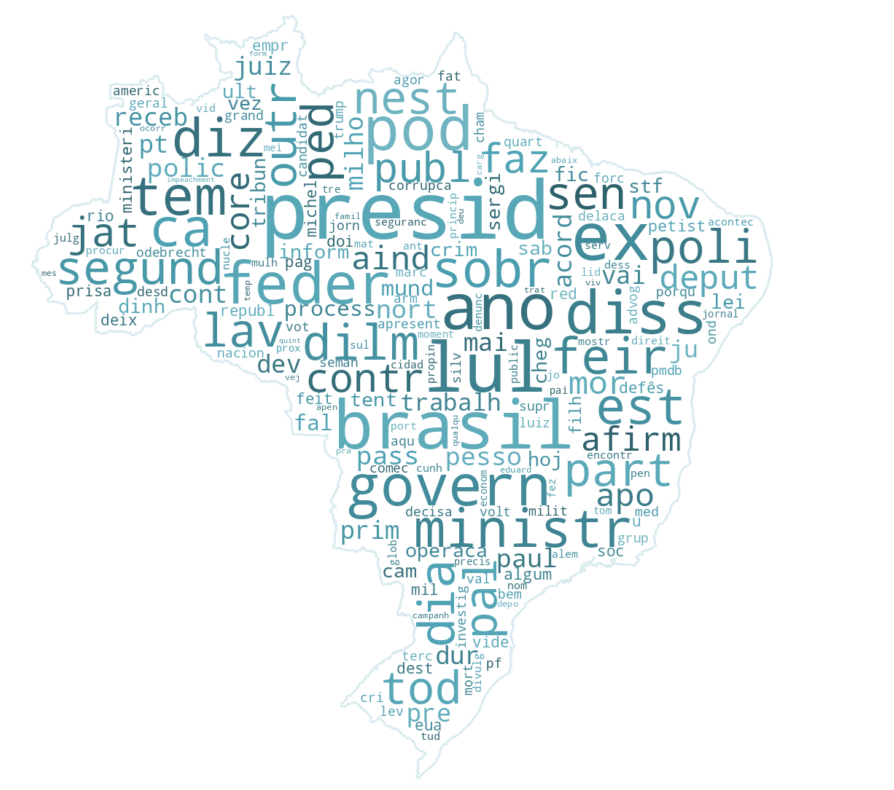

In [101]:
_, all_words, len_all_words = fna.word_cloud_complete(news, "traitement_4", "classification")

   * Were computed a total of 375303 words from dataset.



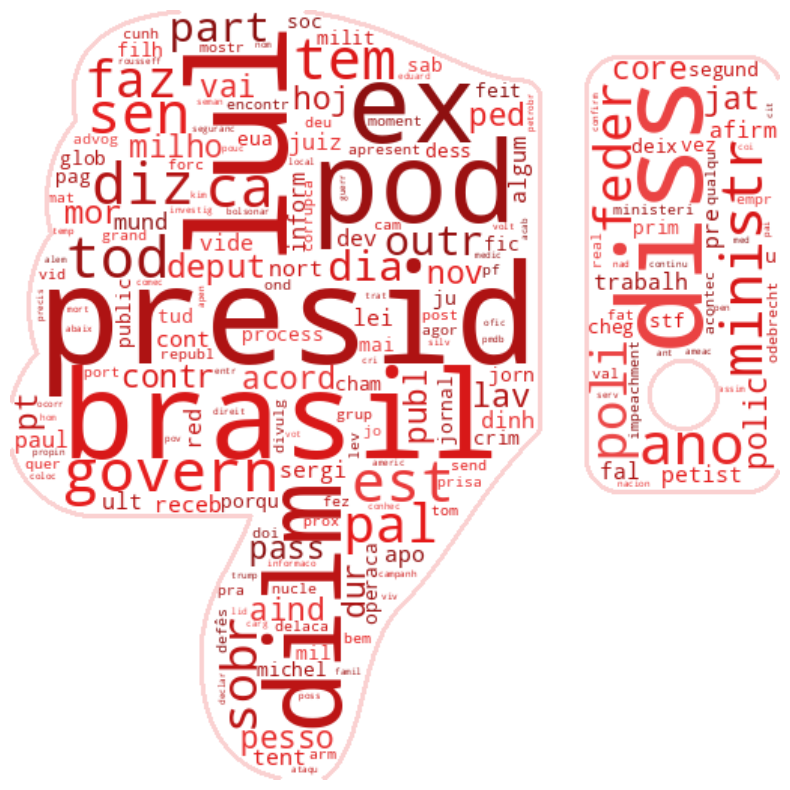

In [102]:
_, fake_words, len_fake_words = fna.word_cloud_fake(news, "traitement_4", "classification")

   * Were computed a total of 375303 words from dataset.



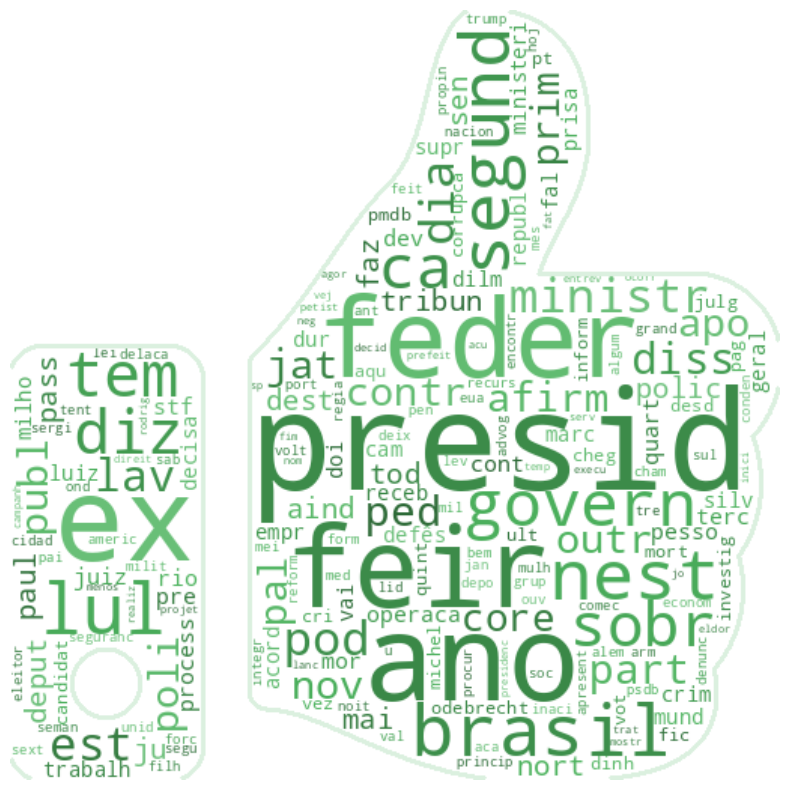

In [103]:
_, real_words, len_real_words = fna.word_cloud_real(news, "traitement_4", "classification")